aim: plot figure: the internal term = intrinsic + bias

In [1]:
import os,sys
import numpy as np
import xarray as xr
import zarr
# plot
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
from matplotlib.colors import Colormap

# plota
import matplotlib.pyplot as plt
from matplotlib.colors import Colormap
import matplotlib.colors as mcolors
import matplotlib.dates as mdates
import matplotlib.cm as cm
import matplotlib.dates as mdates
import matplotlib.ticker as mticker
from matplotlib.colors import from_levels_and_colors
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
CB_colors = {
	'blue':	'#377eb8',
	'orange':  '#ff7f00',
	'green':   '#4daf4a',
	'pink':	'#f781bf',
	'brown':   '#a65628',
	'purple':  '#984ea3',
	'gray':	'#999999',
	'red': 	'#e41a1c',
	'yellow':  '#dede00'
}

# from dask.distributed import Client
# import multiprocessing.popen_spawn_posix
# from distributed import Client

# c = Client()
# c

In [2]:
# dir_sc = os.environ['SCRATCH']
# dir_work = os.environ['WORK']
dir_work = '/gws/nopw/j04/isotipic/stajouri/PhD/Jean_Zay_DIRWORK/uor98hu/'


In [3]:
diri = '/gws/nopw/j04/isotipic/stajouri/PhD/Jean_Zay_DIRWORK/uor98hu/'
mesh_hgr = xr.open_dataset(diri+'eORCA025.L75_domain_cfg_closed_seas_greenland.nc').squeeze()
tmask = mesh_hgr.mppmask
nav_lon =  mesh_hgr.nav_lon
nav_lat =  mesh_hgr.nav_lat
e1t = mesh_hgr.e1t.fillna(0)
e2t = mesh_hgr.e2t.fillna(0)

centim = 1/2.54  # centimeters in inches
proj = ccrs.Robinson(central_longitude=200) #ccrs.Robinson()
crs = ccrs.PlateCarree()
rivers = cartopy.feature.NaturalEarthFeature(category='physical', name='rivers_lake_centerlines',scale='50m',facecolor='none',edgecolor='b')
land  = cfeature.NaturalEarthFeature(name='land',scale='50m', category='physical',facecolor='grey')
label_style = {'size': 8, 'color': '#BDBDBD', 'weight': 'normal'}

lim_sup = 2 # cm²
lim_inf = -0.5
# lim_l4 = 20 # %

cmap12 = cm.YlGn
cmap34 = cm.RdYlBu_r 

In [4]:
diro = dir_work + "/ETUDE3/ENS_VAR_BUDGET/PLOTS/"

# load data

In [5]:
# load data
dir_data = dir_work + "/ETUDE3/ENS_VAR_BUDGET/data4analyses/data4analyses/"
nexp = "ES"

COMP = "SLA"
ds_SLA_39 = xr.open_dataset(dir_data+nexp+"/"+COMP+"/var_terms_39.zarr", engine="zarr")
ds_SLA_3 = xr.open_dataset(dir_data+nexp+"/"+COMP+"/var_terms_3.zarr", engine="zarr")

In [16]:
si_mask

<xarray.DataArray 'SIMASK15_E' (y: 1207, x: 1442)> Size: 2MB
array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)
Dimensions without coordinates: y, x

In [7]:
ds_simask = xr.open_dataset(dir_work+"/ETUDE3/ENS_VAR_BUDGET/raw_data/raw_data/"+nexp+"/"+nexp+"_SIMASK15_E1980_2018.zarr", engine="zarr").SIMASK15_E
si_mask = ds_simask.astype(bool).all(dim=("ens", "time_counter"))
si_mask = si_mask.astype("int8")

# sum_simsk = ds_simask.sum(('ens','time_counter')).compute()
# si_mask = (sum_simsk.where(sum_simsk==390,0)/390)

In [17]:
# compute the signal to noise ration:
def calcul_SNR(ds,threshold): 
    # threshold can be 0.1 or 0.5
    SNR = (ds.res_var / ds.intrinsic_var).where(tmask).where(si_mask)
    intermediate_mask = SNR.where(SNR >=threshold, 0)
    SNR_threshold = intermediate_mask.where(intermediate_mask == 0, 1)
    
    return SNR_threshold

SNR_10_39 = calcul_SNR(ds_SLA_39,0.1)
SNR_10_3 = calcul_SNR(ds_SLA_3,0.1)

SNR_50_39 = calcul_SNR(ds_SLA_39,0.5)
SNR_50_3 = calcul_SNR(ds_SLA_3,0.5)

# pour la SLA: il n'y a pas d'endroit où le biais domine avec la longeur de 39 ans

In [20]:
### compute how much of the globe is explained at more than XX% for each depth range
cellArea = (e1t * e2t).load()
# masking the cells we ignore in this study (land and sea ice cells)
oceanArea = (cellArea * tmask * si_mask)
totalOceanArea = oceanArea.sum()

def calcul_coverage(mask_coverage):   
    perc_coverage = ((cellArea * mask_coverage).sum()/totalOceanArea) *100
    return perc_coverage

In [21]:
coverage_10_39 = calcul_coverage(SNR_10_39)
coverage_10_3 = calcul_coverage(SNR_10_3)

coverage_50_39 = calcul_coverage(SNR_50_39)
coverage_50_3 = calcul_coverage(SNR_50_3)

print("% of the globe")
print(np.round(coverage_10_39.values,1))
print(np.round(coverage_10_3.values,1))
print(np.round(coverage_50_39.values,1))
print(np.round(coverage_50_3.values,1))

% of the globe
16.7
99.5
0.0
34.4


# plot figure

In [22]:
# my_cmap = mcolors.LinearSegmentedColormap.from_list("my_map",  [(1,0,0)] , N=1)
def vectorize(cs):
    """
    Vectorize contourf plots to reduce weight of figures saved as PDFs.
    """
    for c in cs.collections:
        c.set_rasterized(True)

alphaHatch = 0.5

## pour la SLA

<ipython-input-15-a416c4136fe1>:34: FutureWarning: xarray.ufuncs is deprecated. Instead, use numpy ufuncs directly.
  cs= axa.pcolormesh(nav_lon, nav_lat, xr.ufuncs.log10((ds_SLA_39.intrinsic_var - ds_SLA_39.res_var) * si_mask),\
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/xarray/core/dataarray.py:3078: FutureWarning: xarray.ufuncs is deprecated. Instead, use numpy ufuncs directly.
  da = self.__array_wrap__(f(self.variable.data, *args, **kwargs))
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1597: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  X, Y, C, shading = self._pcolorargs('pcolormesh', *args,
<ipython-input-

figure_SLA_3.png


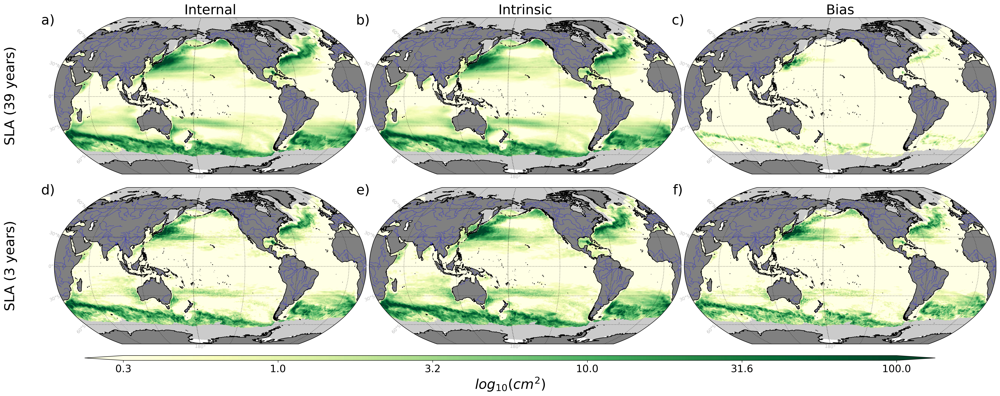

In [15]:
fig, [(axa,axb,axc),(axd,axe,axf)] = plt.subplots(2, 3,figsize=(30,12),facecolor='white', \
                                                                             dpi=300,subplot_kw={'projection': proj})
plt.subplots_adjust(wspace=0.01, hspace=0)

axa.text(-0.14, 0.5, "SLA (39 years)", fontsize=24, horizontalalignment='center', verticalalignment='center',rotation='vertical', transform=axa.transAxes)
axd.text(-0.14, 0.5, "SLA (3 years)", fontsize=24, horizontalalignment='center', verticalalignment='center',rotation='vertical', transform=axd.transAxes)

axa.set_title("Internal", fontsize=24) 
axb.set_title("Intrinsic", fontsize=24) 
axc.set_title("Bias", fontsize=24) 

axa.text(-0.02, 0.98, 'a)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axa.transAxes)
axb.text(-0.02, 0.98, 'b)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axb.transAxes)
axc.text(-0.02, 0.98, 'c)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axc.transAxes)

axd.text(-0.02, 0.98, 'd)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axd.transAxes)
axe.text(-0.02, 0.98, 'e)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axe.transAxes)
axf.text(-0.02, 0.98, 'f)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axf.transAxes)

for ax_name in [axa,axb,axc, axd,axe,axf]:
    # ax_name.coastlines()
    gl = ax_name.gridlines(color='k',alpha=0.5, linestyle='--',linewidth=0.33,lw=1,ls=':', draw_labels=True)#, y_inline=True,)
    gl.top_labels = False
    gl.right_labels = False
    gl.xlabel_style = label_style; gl.ylabel_style = label_style
    ax_name.add_feature(land, edgecolor='black')
    clr2 = ax_name.add_feature(rivers,alpha=0.3,facecolor='none',edgecolor='blue',zorder=6)
    ax_name.contourf(nav_lon,nav_lat,si_mask.where(si_mask==0).where(nav_lon<0),1,colors=CB_colors['gray'], transform=crs, alpha=0.5)
    ax_name.contourf(nav_lon,nav_lat,si_mask.where(si_mask==0).where(nav_lon>0),1,colors=CB_colors['gray'],transform=crs, alpha=0.5)


#--------------------- premiere ligne :  39 years--------------------------------------
# ========total
cs= axa.pcolormesh(nav_lon, nav_lat, xr.ufuncs.log10((ds_SLA_39.intrinsic_var - ds_SLA_39.res_var) * si_mask),\
                   shading='flat', cmap =cmap12, transform=crs, vmin =lim_inf, vmax=lim_sup)
# ========FORCED
cs= axb.pcolormesh(nav_lon, nav_lat, xr.ufuncs.log10( ds_SLA_39.intrinsic_var * si_mask), shading='flat',cmap =cmap12, transform=crs, vmin =lim_inf, vmax=lim_sup)
# # ========internal
cs= axc.pcolormesh(nav_lon, nav_lat, xr.ufuncs.log10( ds_SLA_39.res_var * si_mask ), shading='flat',cmap =cmap12, transform=crs, vmin =lim_inf, vmax=lim_sup)

# ratio maps
# axa.contour(nav_lon,nav_lat,data.where(nav_lon<0),1,colors=CB_colors['red'], transform=crs, alpha=0.5)
# axa.contour(nav_lon,nav_lat,data.where(nav_lon>0),1,colors=CB_colors['red'],transform=crs, alpha=0.5)

# #### mask 10 %
# cs2_2= ax1.contourf(nav_lon, nav_lat, SNR_10_39.where(SNR_10_39==1).where(nav_lon<0),1,transform=crs,colors='blue',alpha=0.4)
# vectorize(cs2_2)
# cs2_1= ax1.contourf(nav_lon, nav_lat,SNR_10_39.where(SNR_10_39==1).where(nav_lon>0),1,transform=crs,colors='blue',alpha=0.4)
# vectorize(cs2_1)

# #### mask 50 %
# cs2_2= ax1.contourf(nav_lon, nav_lat, SNR_50_39.where(SNR_50_39==1).where(nav_lon<0),1,transform=crs,colors='red',alpha=0.9)
# vectorize(cs2_2)
# cs2_1= ax1.contourf(nav_lon, nav_lat,SNR_50_39.where(SNR_50_39==1).where(nav_lon>0),1,transform=crs, colors='red',alpha=0.9)
# vectorize(cs2_1)

#--------------------- deuxieme ligne :  3 years--------------------------------------
# ========total
cs= axd.pcolormesh(nav_lon, nav_lat, xr.ufuncs.log10((ds_SLA_3.intrinsic_var - ds_SLA_3.res_var) * si_mask),\
                   shading='flat', cmap =cmap12, transform=crs, vmin =lim_inf, vmax=lim_sup)
# # ========FORCED
cs= axe.pcolormesh(nav_lon, nav_lat, xr.ufuncs.log10( ds_SLA_3.intrinsic_var * si_mask), shading='flat',cmap =cmap12, transform=crs, vmin =lim_inf, vmax=lim_sup)
# ========internal
cs= axf.pcolormesh(nav_lon, nav_lat, xr.ufuncs.log10( ds_SLA_3.res_var * si_mask ), shading='flat',cmap =cmap12, transform=crs, vmin =lim_inf, vmax=lim_sup)

## ratio maps
# ratio maps
# axa.contour(nav_lon,nav_lat,data.where(nav_lon<0),1,colors=CB_colors['red'], transform=crs, alpha=0.5)
# axa.contour(nav_lon,nav_lat,data.where(nav_lon>0),1,colors=CB_colors['red'],transform=crs, alpha=0.5)

#### mask 10 %
# cs2_2= ax2.contourf(nav_lon, nav_lat, SNR_10_3.where(SNR_10_3==1).where(nav_lon<0),1,transform=crs,colors='blue',alpha=0.4)
# vectorize(cs2_2)
# cs2_1= ax2.contourf(nav_lon, nav_lat,SNR_10_3.where(SNR_10_3==1).where(nav_lon>0),1,transform=crs,colors='blue',alpha=0.4)
# vectorize(cs2_1)

# #### mask 50 %
# cs2_2= ax2.contourf(nav_lon, nav_lat, SNR_50_3.where(SNR_50_3==1).where(nav_lon<0),1,transform=crs,colors='red',alpha=0.9)
# vectorize(cs2_2)
# cs2_1= ax2.contourf(nav_lon, nav_lat,SNR_50_3.where(SNR_50_3==1).where(nav_lon>0),1,transform=crs,colors='red',alpha=0.9)
# vectorize(cs2_1)

############--------------------------------------------
fig.subplots_adjust(bottom=0.18)
# cbar_ax = fig.add_axes([0.15, 0.16, 0.5, 0.01])  #(left, bottom, width, height)
cbar_ax = fig.add_axes([0.15, 0.16, 0.7, 0.01])  #(left, bottom, width, height)

ticklabels=np.arange(-0.5,2.5,0.5)
new_tickslabels = [np.round(10**y,1) for y in ticklabels]

cbar = fig.colorbar(cs,extend='both', cax=cbar_ax, orientation='horizontal', ticks=ticklabels) # pad = 0.025, shrink=0.9) ticks=bounds,
cbar.ax.tick_params(labelsize=18)
cbar.set_ticklabels(new_tickslabels)
# cbar.ax.set_title('$log_{10}(cm^{2})$',size=14)
cbar.set_label(r'$log_{10}(cm^{2})$', fontsize=24)
# cbar.set_ticks(ticks=np.arange(-0.5,2.5,0.5))

namo = "figure_"+COMP+"_3.png"
print(namo)
# fig.tight_layout(pad=0, h_pad=5, w_pad=0)
plt.show()
fig.savefig(diro+namo, facecolor=fig.get_facecolor(), bbox_inches='tight') #,edgecolor='none',
# plt.close(fig)

In [16]:
diro+namo

'/lustre/fswork/projects/rech/cli/uor98hu/ETUDE3/ENS_VAR_BUDGET/PLOTS/figure_SLA_3.png'

# FIGURE for the COMP STERIC MANO THERMO HALO

## Prepare data

In [23]:
# for the components of sea level
def compute_mask(COMP): 
    if COMP in ["MANO","SLA"]:
        ds_SLA_39 = xr.open_dataset(dir_data+nexp+"/"+COMP+"/var_terms_39.zarr", engine="zarr")
        ds_SLA_3 = xr.open_dataset(dir_data+nexp+"/"+COMP+"/var_terms_3.zarr", engine="zarr")
    else:
        ds_SLA_39 = xr.open_dataset(dir_data+nexp+"/"+COMP+"/var_terms_39_0_bottom.zarr", engine="zarr")
        ds_SLA_3 = xr.open_dataset(dir_data+nexp+"/"+COMP+"/var_terms_3_0_bottom.zarr", engine="zarr")
    
    SNR_10_39 = calcul_SNR(ds_SLA_39,0.1)
    SNR_10_3 = calcul_SNR(ds_SLA_3,0.1)
    
    SNR_50_39 = calcul_SNR(ds_SLA_39,0.5)
    SNR_50_3 = calcul_SNR(ds_SLA_3,0.5)
    
    coverage_10_39 = calcul_coverage(SNR_10_39)
    coverage_10_3 = calcul_coverage(SNR_10_3)
    
    coverage_50_39 = calcul_coverage(SNR_50_39)
    coverage_50_3 = calcul_coverage(SNR_50_3)

    return [SNR_10_39, SNR_50_39, SNR_10_3, SNR_50_3], [coverage_10_39, coverage_50_39, coverage_10_3, coverage_50_3]

list_masks_SLA, list_coverage_SLA = compute_mask("SLA")
list_masks_STERIC, list_coverage_STERIC = compute_mask("STERIC")
list_masks_MANO,   list_coverage_MANO   = compute_mask("MANO")
list_masks_THERMO, list_coverage_THERMO = compute_mask("THERMO")
list_masks_HALO,   list_coverage_HALO   = compute_mask("HALO")

SLA_values = np.round(list_coverage_SLA,1)
STERIC_values =  np.round(list_coverage_STERIC,1)
MANO_values = np.round(list_coverage_MANO,1)
THERMO_values = np.round(list_coverage_THERMO,1)
HALO_values = np.round(list_coverage_HALO,1)

print("% of the globe: 10% 39 years, 50% 39 years, 10% 3 years, 50% 3 years")
print("SLA", np.round(list_coverage_SLA,1))
print("STERIC", np.round(list_coverage_STERIC,1))
print("MANO", np.round(list_coverage_MANO,1))
print("THERMO", np.round(list_coverage_THERMO,1))
print("HALO", np.round(list_coverage_HALO,1))

% of the globe: 10% 39 years, 50% 39 years, 10% 3 years, 50% 3 years
SLA [16.7  0.  99.5 34.4]
STERIC [19.9  0.2 99.5 37.5]
MANO [ 6.7  0.  98.2 13.7]
THERMO [10.4  0.7 99.7 39.4]
HALO [36.1  3.  99.9 70.2]


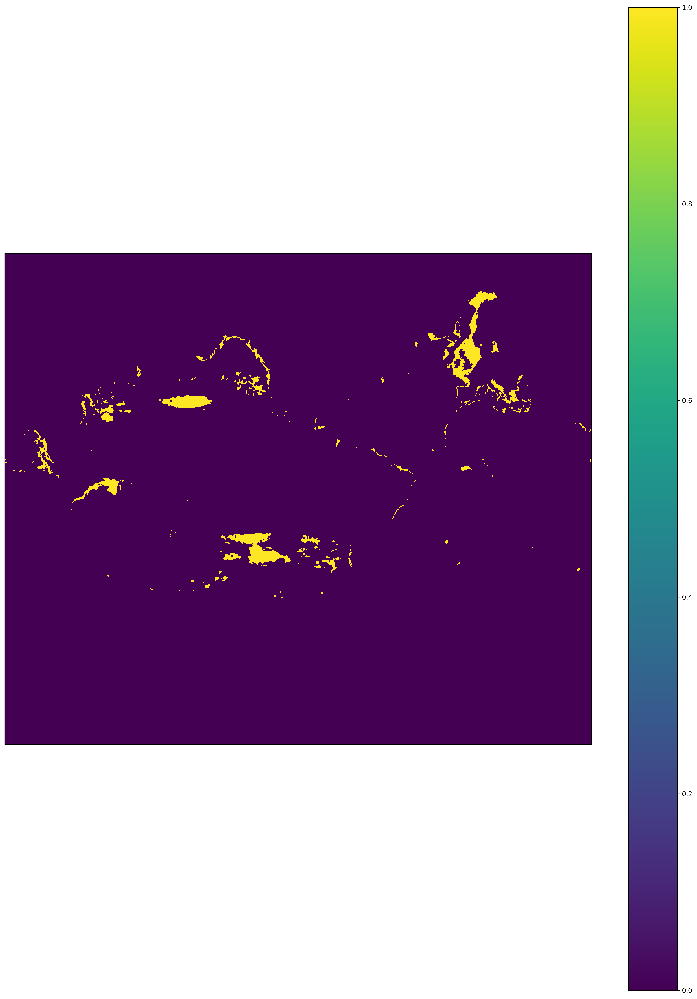

In [32]:
crossthe = list_masks_THERMO[0]*list_masks_THERMO[3]
crossste = list_masks_STERIC[0]*list_masks_STERIC[3]
crosssla = list_masks_SLA[0]*list_masks_SLA[3]

crossall = crossthe * crossste * crosssla
# cross.plot()
fig, ax= plt.subplots(1, 1,figsize=(20,27),facecolor='white', dpi=300,subplot_kw={'projection': proj})
ax.add_feature(land, edgecolor='black')
crossall.plot(ax=ax)


# PLOT figure

In [18]:
def plot_contourf(data, ax):
    """aim: plot the two maks 10% and 50 % on a same map
        data: is a list of two elements [mask 10%, mask 50%]
    """
    #### mask 50 %
    cs2_2= ax.contourf(nav_lon, nav_lat, data[1].where(data[1]==1).where(nav_lon<0),transform=crs, colors='red',alpha=0.9, zorder=2)
    vectorize(cs2_2)
    cs2_1= ax.contourf(nav_lon, nav_lat,data[1].where(data[1]==1).where(nav_lon>0),transform=crs, colors='red',alpha=0.9, zorder=2)
    vectorize(cs2_1)
    
    #### mask 10 %
    cs2_2= ax.contourf(nav_lon, nav_lat, data[0].where(data[0]==1).where(nav_lon<0),transform=crs,colors='blue',alpha=0.4,zorder=1)
    vectorize(cs2_2)
    cs2_1= ax.contourf(nav_lon, nav_lat,data[0].where(data[0]==1).where(nav_lon>0),transform=crs, colors='blue',alpha=0.4, zorder=1)
    vectorize(cs2_1)
    

In [50]:
def print_text_39(data,ax):
    t = ax.text(0.26,0.93,str(data[0])+"%", color='blue', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)
    t.set_bbox(dict(facecolor='white', alpha=1, edgecolor='white'))

    t = ax.text(0.65,0.93,str(data[1])+"%", color='red', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)
    t.set_bbox(dict(facecolor='white', alpha=1, edgecolor='white'))

def print_text_3(data,ax):
    t = ax.text(0.26,0.93,str(data[2])+"%", color='blue', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)
    t.set_bbox(dict(facecolor='white', alpha=1, edgecolor='white'))

    t = ax.text(0.65,0.93,str(data[3])+"%", color='red', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)
    t.set_bbox(dict(facecolor='white', alpha=1, edgecolor='white'))

/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/gpfslocalsup/pub/anaconda-py3/2020.11/envs/climate_science/lib/python3.9/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


figure4_masks_paper.png


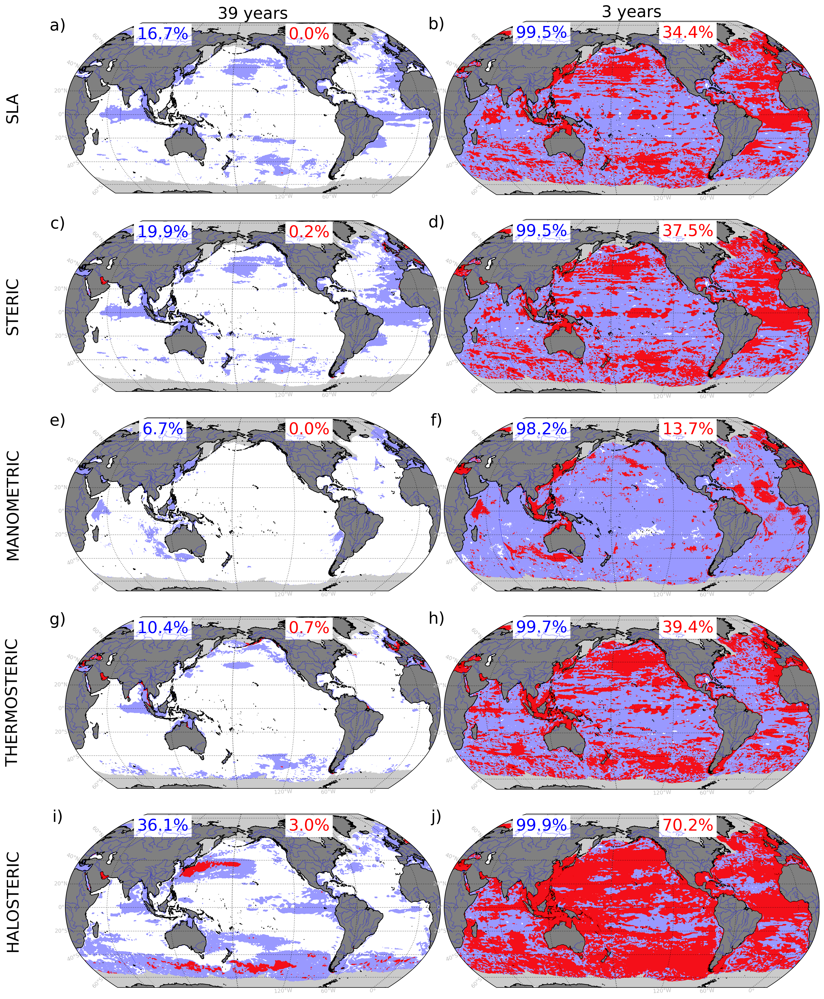

In [52]:
fig, [(axa,axb),(axc, axd),(axe,axf),(axg, axh),(axi,axj)] = plt.subplots(5, 2,figsize=(20,27),facecolor='white', \
                                                                             dpi=300,subplot_kw={'projection': proj})
plt.subplots_adjust(wspace=0.01, hspace=0)

axa.set_title("39 years", fontsize=24) 
axb.set_title("3 years", fontsize=24) 

axa.text(-0.14, 0.5, "SLA", fontsize=24, horizontalalignment='center', verticalalignment='center',rotation='vertical', transform=axa.transAxes)
axc.text(-0.14, 0.5,  "STERIC", fontsize=24, horizontalalignment='center', verticalalignment='center',rotation='vertical', transform=axc.transAxes)
axe.text(-0.14, 0.5, "MANOMETRIC" , fontsize=24, horizontalalignment='center', verticalalignment='center',rotation='vertical', transform=axe.transAxes)
axg.text(-0.14, 0.5, "THERMOSTERIC" , fontsize=24, horizontalalignment='center', verticalalignment='center',rotation='vertical', transform=axg.transAxes)
axi.text(-0.14, 0.5, "HALOSTERIC" , fontsize=24, horizontalalignment='center', verticalalignment='center',rotation='vertical', transform=axi.transAxes)

axa.text(-0.02, 0.98, 'a)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axa.transAxes)
axb.text(-0.02, 0.98, 'b)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axb.transAxes)
axc.text(-0.02, 0.98, 'c)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axc.transAxes)
axd.text(-0.02, 0.98, 'd)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axd.transAxes)
axe.text(-0.02, 0.98, 'e)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axe.transAxes)
axf.text(-0.02, 0.98, 'f)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axf.transAxes)
axg.text(-0.02, 0.98, 'g)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axg.transAxes)
axh.text(-0.02, 0.98, 'h)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axh.transAxes)
axi.text(-0.02, 0.98, 'i)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axi.transAxes)
axj.text(-0.02, 0.98, 'j)', fontsize=24, horizontalalignment='center', verticalalignment='center', transform=axj.transAxes)


for ax_name in [axa,axb,axc,axd,axe,axf,axg,axh,axi,axj]:
    # ax_name.coastlines()
    gl = ax_name.gridlines(color='k',alpha=0.5, linestyle='--',linewidth=0.33,lw=1,ls=':', draw_labels=True)#, y_inline=True,)
    gl.top_labels = False
    gl.right_labels = False
    gl.xlabel_style = label_style; gl.ylabel_style = label_style
    ax_name.add_feature(land, edgecolor='black')
    clr2 = ax_name.add_feature(rivers,alpha=0.3,facecolor='none',edgecolor='blue',zorder=6)
    ax_name.contourf(nav_lon,nav_lat,si_mask.where(si_mask==0).where(nav_lon<0),1,colors=CB_colors['gray'], transform=crs, alpha=0.5)
    ax_name.contourf(nav_lon,nav_lat,si_mask.where(si_mask==0).where(nav_lon>0),1,colors=CB_colors['gray'],transform=crs, alpha=0.5)

#--------------------- premiere colonne :  39 years--------------------------------------
plot_contourf(list_masks_SLA[0:2], axa);    print_text_39(SLA_values, axa)
plot_contourf(list_masks_STERIC[0:2], axc); print_text_39(STERIC_values, axc)
plot_contourf(list_masks_MANO[0:2], axe);   print_text_39(MANO_values, axe)
plot_contourf(list_masks_THERMO[0:2], axg); print_text_39(THERMO_values, axg)
plot_contourf(list_masks_HALO[0:2], axi);   print_text_39(HALO_values, axi)


# --------------------- deuxieme colonne :  3 years--------------------------------------
plot_contourf(list_masks_SLA[2:4], axb) ;   print_text_3(SLA_values, axb)
plot_contourf(list_masks_STERIC[2:4], axd); print_text_3(STERIC_values, axd)
plot_contourf(list_masks_MANO[2:4], axf);   print_text_3(MANO_values, axf)
plot_contourf(list_masks_THERMO[2:4], axh); print_text_3(THERMO_values, axh)
plot_contourf(list_masks_HALO[2:4], axj);   print_text_3(HALO_values, axj)

############--------------------------------------------

namo = "figure4_masks_paper.png"
print(namo)
# fig.tight_layout(pad=0, h_pad=5, w_pad=0)
plt.show()
fig.savefig(diro+namo, facecolor=fig.get_facecolor(), bbox_inches='tight') #,edgecolor='none',
# plt.close(fig)

In [53]:
diro+namo

'/lustre/fswork/projects/rech/cli/uor98hu/ETUDE3/ENS_VAR_BUDGET/PLOTS/figure4_masks_paper.png'